In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import folium

Projemizde 1688 yılından 2013 yılına kadar Dünya'ya düşmüş olan meteorları fonksiyonlarla, grafiklerle ve folium kütüphanesi ile haritalandırarak farklı metotlarla inceledik. Bu verileri 45.715 satır veri içeren 'meteor.csv' dosyamızdan aldık ve bu verileri temizleyerek 'cleaned_meteor.csv' dosyamıza atadık. Bunun sonucunda toplamda 45.715 satırlık veriyi temizleyerek 16.889 satırlık daha kullanışlı bir veriye dönüştürmüş olduk.

In [2]:
df = pd.read_csv("meteor.csv")
df

,Meteor Name,ID,Name Type,Class,Mass,Fall,Year,Latitude,Longitude,Geolocation
0,Aachen,1,Valid,L5,21.0,Fell,1880.0,50.77500,6.08333,"(50.775, 6.08333)"
1,Aarhus,2,Valid,H6,720.0,Fell,1951.0,56.18333,10.23333,"(56.18333, 10.23333)"
2,Abee,6,Valid,EH4,107000.0,Fell,1952.0,54.21667,-113.00000,"(54.21667, -113.0)"
3,Acapulco,10,Valid,Acapulcoite,1914.0,Fell,1976.0,16.88333,-99.90000,"(16.88333, -99.9)"
4,Achiras,370,Valid,L6,780.0,Fell,1902.0,-33.16667,-64.95000,"(-33.16667, -64.95)"
...,...,...,...,...,...,...,...,...,...,...
45710,Zillah 002,31356,Valid,Eucrite,172.0,Found,1990.0,29.03700,17.01850,"(29.037, 17.0185)"
45711,Zinder,30409,Valid,"Pallasite, ungrouped",46.0,Found,1999.0,13.78333,8.96667,"(13.78333, 8.96667)"
45712,Zlin,30410,Valid,H4,3.3,Found,1939.0,49.25000,17.66667,"(49.25, 17.66667)"
45713,Zubkovsky,31357,Valid,L6,2167.0,Found,2003.0,49.78917,41.50460,"(49.78917, 41.5046)"


In [3]:
df['Year'] = pd.to_datetime(df['Year'], format='%Y', errors='coerce').dt.year.astype('Int32')
df

,Meteor Name,ID,Name Type,Class,Mass,Fall,Year,Latitude,Longitude,Geolocation
0,Aachen,1,Valid,L5,21.0,Fell,1880,50.77500,6.08333,"(50.775, 6.08333)"
1,Aarhus,2,Valid,H6,720.0,Fell,1951,56.18333,10.23333,"(56.18333, 10.23333)"
2,Abee,6,Valid,EH4,107000.0,Fell,1952,54.21667,-113.00000,"(54.21667, -113.0)"
3,Acapulco,10,Valid,Acapulcoite,1914.0,Fell,1976,16.88333,-99.90000,"(16.88333, -99.9)"
4,Achiras,370,Valid,L6,780.0,Fell,1902,-33.16667,-64.95000,"(-33.16667, -64.95)"
...,...,...,...,...,...,...,...,...,...,...
45710,Zillah 002,31356,Valid,Eucrite,172.0,Found,1990,29.03700,17.01850,"(29.037, 17.0185)"
45711,Zinder,30409,Valid,"Pallasite, ungrouped",46.0,Found,1999,13.78333,8.96667,"(13.78333, 8.96667)"
45712,Zlin,30410,Valid,H4,3.3,Found,1939,49.25000,17.66667,"(49.25, 17.66667)"
45713,Zubkovsky,31357,Valid,L6,2167.0,Found,2003,49.78917,41.50460,"(49.78917, 41.5046)"


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45715 entries, 0 to 45714
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Meteor Name  45715 non-null  object 
 1   ID           45715 non-null  int64  
 2   Name Type    45715 non-null  object 
 3   Class        45715 non-null  object 
 4   Mass         45584 non-null  float64
 5   Fall         45715 non-null  object 
 6   Year         45403 non-null  Int32  
 7   Latitude     38400 non-null  float64
 8   Longitude    38400 non-null  float64
 9   Geolocation  38400 non-null  object 
dtypes: Int32(1), float64(3), int64(1), object(5)
memory usage: 3.4+ MB


In [5]:
df.isnull().sum()

Meteor Name       0
ID                0
Name Type         0
Class             0
Mass            131
Fall              0
Year            312
Latitude       7315
Longitude      7315
Geolocation    7315
dtype: int64

In [6]:
df = df.dropna(subset=['Mass','Year'])
df = df[(df['Mass'] != 0) & (df['Mass'] != 0.0) & (df['Year'] != 0) & (df['Year'] != 0.0)]
df.to_csv('cleaned_meteor.csv', index=False)
df.isnull().sum()

Meteor Name       0
ID                0
Name Type         0
Class             0
Mass              0
Fall              0
Year              0
Latitude       7195
Longitude      7195
Geolocation    7195
dtype: int64

In [7]:
df = df.dropna(subset=['Latitude', 'Longitude'])
df = df[(df['Latitude'] != 0) & (df['Latitude'] != 0.0) & (df['Longitude'] != 0) & (df['Longitude'] != 0.0)]
df = df.drop_duplicates(subset=['Latitude', 'Longitude'])

df.to_csv('cleaned_meteor.csv', index=False)
df.isnull().sum()

Meteor Name    0
ID             0
Name Type      0
Class          0
Mass           0
Fall           0
Year           0
Latitude       0
Longitude      0
Geolocation    0
dtype: int64

In [8]:
df

,Meteor Name,ID,Name Type,Class,Mass,Fall,Year,Latitude,Longitude,Geolocation
0,Aachen,1,Valid,L5,21.0,Fell,1880,50.77500,6.08333,"(50.775, 6.08333)"
1,Aarhus,2,Valid,H6,720.0,Fell,1951,56.18333,10.23333,"(56.18333, 10.23333)"
2,Abee,6,Valid,EH4,107000.0,Fell,1952,54.21667,-113.00000,"(54.21667, -113.0)"
3,Acapulco,10,Valid,Acapulcoite,1914.0,Fell,1976,16.88333,-99.90000,"(16.88333, -99.9)"
4,Achiras,370,Valid,L6,780.0,Fell,1902,-33.16667,-64.95000,"(-33.16667, -64.95)"
...,...,...,...,...,...,...,...,...,...,...
45709,Zillah 001,31355,Valid,L6,1475.0,Found,1990,29.03700,17.01850,"(29.037, 17.0185)"
45711,Zinder,30409,Valid,"Pallasite, ungrouped",46.0,Found,1999,13.78333,8.96667,"(13.78333, 8.96667)"
45712,Zlin,30410,Valid,H4,3.3,Found,1939,49.25000,17.66667,"(49.25, 17.66667)"
45713,Zubkovsky,31357,Valid,L6,2167.0,Found,2003,49.78917,41.50460,"(49.78917, 41.5046)"


In [9]:
i = "Name Type"
df.drop(i, axis=1,inplace=True)
df

,Meteor Name,ID,Class,Mass,Fall,Year,Latitude,Longitude,Geolocation
0,Aachen,1,L5,21.0,Fell,1880,50.77500,6.08333,"(50.775, 6.08333)"
1,Aarhus,2,H6,720.0,Fell,1951,56.18333,10.23333,"(56.18333, 10.23333)"
2,Abee,6,EH4,107000.0,Fell,1952,54.21667,-113.00000,"(54.21667, -113.0)"
3,Acapulco,10,Acapulcoite,1914.0,Fell,1976,16.88333,-99.90000,"(16.88333, -99.9)"
4,Achiras,370,L6,780.0,Fell,1902,-33.16667,-64.95000,"(-33.16667, -64.95)"
...,...,...,...,...,...,...,...,...,...
45709,Zillah 001,31355,L6,1475.0,Found,1990,29.03700,17.01850,"(29.037, 17.0185)"
45711,Zinder,30409,"Pallasite, ungrouped",46.0,Found,1999,13.78333,8.96667,"(13.78333, 8.96667)"
45712,Zlin,30410,H4,3.3,Found,1939,49.25000,17.66667,"(49.25, 17.66667)"
45713,Zubkovsky,31357,L6,2167.0,Found,2003,49.78917,41.50460,"(49.78917, 41.5046)"


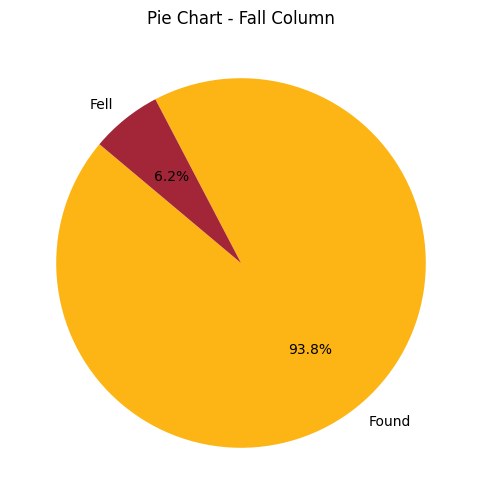

In [10]:
fall_column = df['Fall']
value = fall_column.value_counts()
colors ='#FCB514','#A32638'
plt.figure(figsize=(6,6))
plt.pie(value, labels=value.index, autopct='%1.1f%%', startangle=140, colors=colors)
plt.title('Pie Chart - Fall Column')
plt.show()

C:\Users\Mustafa\AppData\Local\Temp\ipykernel_5256\211716677.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=meteor_sayilari.index, y=meteor_sayilari.values, palette='viridis')


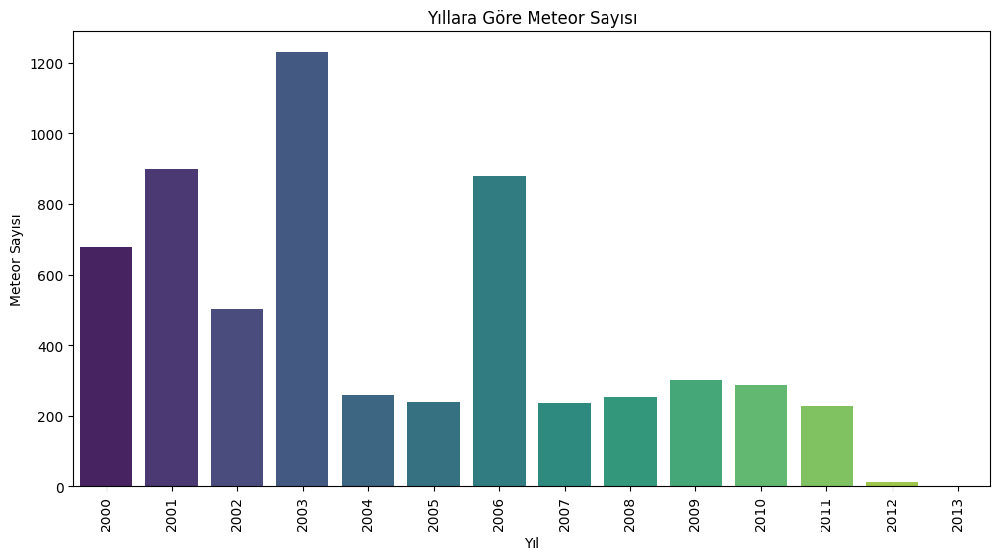

In [11]:
df['Year'] = pd.to_datetime(df['Year'], format='%Y', errors='coerce')
df_year = df[df['Year'].dt.year >= 2000] 
df_year.loc[:, 'Year'] = df_year['Year'].dt.year.astype('int32')

meteor_sayilari = df_year['Year'].value_counts().sort_index()

ortalama_yil = (meteor_sayilari.index * meteor_sayilari).sum() / meteor_sayilari.sum()

meteor_sayilari.plot(kind='bar', figsize=(12, 6))
sns.barplot(x=meteor_sayilari.index, y=meteor_sayilari.values, palette='viridis')
plt.xlabel('Yıl')
plt.ylabel('Meteor Sayısı')
plt.title('Yıllara Göre Meteor Sayısı')
plt.show()

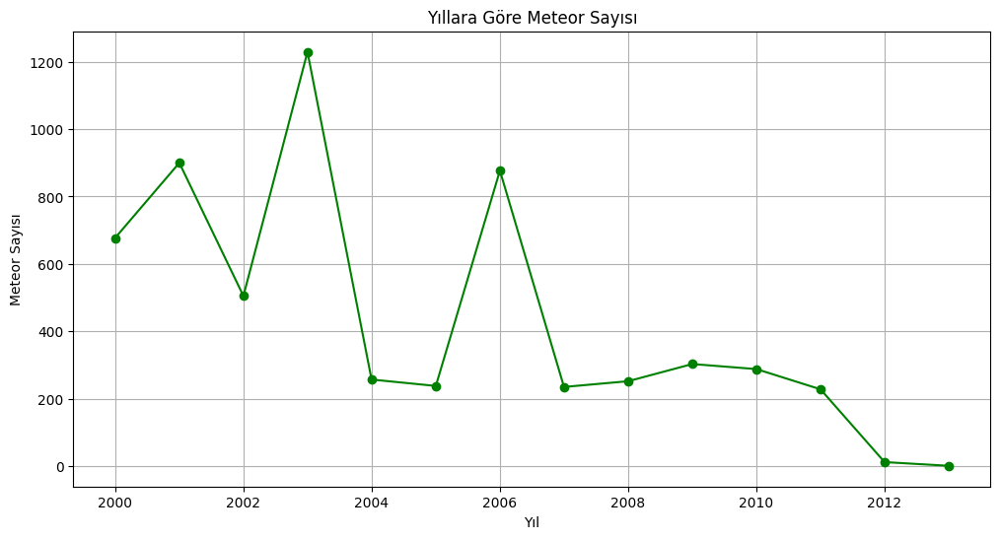

In [12]:
df['Year'] = pd.to_datetime(df['Year'], format='%Y', errors='coerce')
df_2000 = df[df['Year'].dt.year >= 2000] 
df_year.loc[:, 'Year'] = df_2000['Year'].dt.year.astype('int32')

meteor_sayilari = df_2000['Year'].value_counts().sort_index()

plt.figure(figsize=(12, 6))
plt.plot(meteor_sayilari.index, meteor_sayilari.values,color='Green', marker='o', linestyle='-')
plt.xlabel('Yıl')
plt.ylabel('Meteor Sayısı')
plt.title('Yıllara Göre Meteor Sayısı')
plt.grid(True)
plt.show()

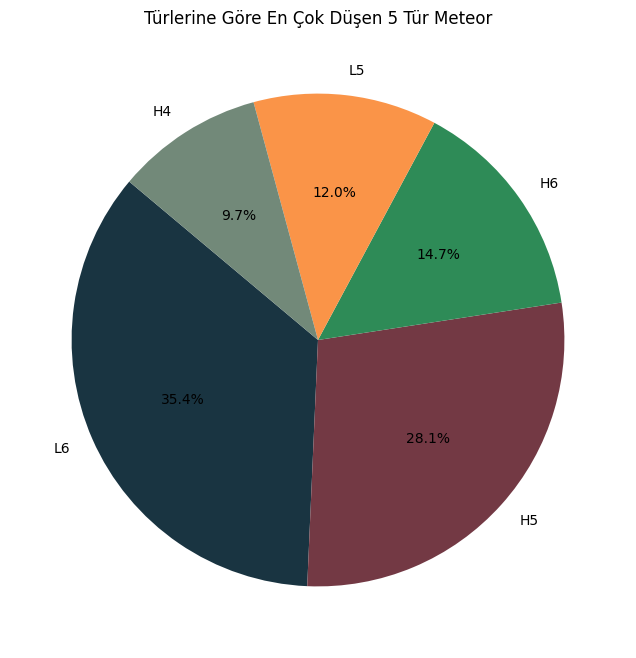

In [13]:
class_sutun = 'Class'  
sinif_sayilari = df[class_sutun].value_counts().head(5)

colors = ['#193441', '#733944', 'seagreen', '#FA9448', '#728979']

plt.figure(figsize=(8, 8))
plt.pie(sinif_sayilari, labels=sinif_sayilari.index, autopct='%1.1f%%', startangle=140, colors=colors)
plt.title('Türlerine Göre En Çok Düşen 5 Tür Meteor')
plt.show()

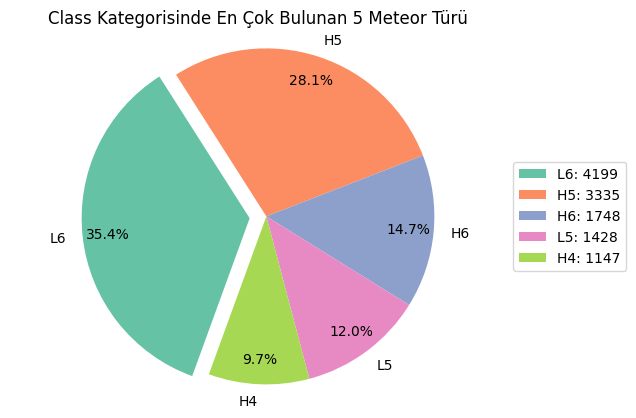

In [14]:
class_counts = df['Class'].value_counts()

top_classes = class_counts.index[:5]

sizes = class_counts[top_classes].values

labels = top_classes

colors = sns.color_palette("Set2")

fig, ax = plt.subplots()

wedges, texts, autotexts = ax.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=250, pctdistance=0.85, counterclock=False, explode=(0.1, 0, 0, 0, 0))
ax.axis('equal')  

ax.set_title('Class Kategorisinde En Çok Bulunan 5 Meteor Türü')

legend_labels = [f'{label}: {count}' for label, count in zip(top_classes, sizes)]
ax.legend(wedges, legend_labels, loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

plt.show()

In [15]:
from folium.plugins import MarkerCluster

df = pd.read_csv('cleaned_meteor.csv')

m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=12)

marker_cluster = MarkerCluster().add_to(m)

for index, row in df.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']], 
                  popup=f"{row['Class']} - {row['Year']} - {row['Mass']}",
                  tooltip=row['Meteor Name']).add_to(marker_cluster)

m.save('harita.html')
m

In [16]:
from folium import plugins

df = pd.read_csv('cleaned_meteor.csv')
map_center = [df['Latitude'].mean(), df['Longitude'].mean()]
my_map = folium.Map(location=map_center, zoom_start=4)
heat_data = [[row['Latitude'], row['Longitude']] for index, row in df.iterrows()]
heat_map = plugins.HeatMap(heat_data)
heat_map.add_to(my_map)
my_map.save('isi_haritasi.html')
my_map

Hem atölye sürecimizde hemde projemizi geliştirme aşamasında bize yardım eden, atölye mentörümüz Yusuf Esat'a çok teşekkür ederiz. 🚀⚡

Geliştiriciler: Mustafa ÇELEBİ & Feride İkbal DURMUŞ